In [1]:
%load_ext autoreload
%autoreload 2

import numpy as np
import pandas as pd
import h5py

import astropy.units as u
from astropy.table import Table, Column, join
from IPython.display import Image, display

from matplotlib.ticker import FormatStrFormatter
from matplotlib import pyplot as plt

from caterpillar import catalog

import sys
sys.path.insert(1, '/home/ksf293/anomalies-GAN-HSC/analysis')
import plotter
import utils

In [2]:
import matplotlib
from matplotlib import pylab

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
matplotlib.rcParams['figure.dpi'] = 200
params = {'legend.fontsize': 'large',
          'figure.figsize': (6, 4),
         'axes.labelsize': 'large',
         'axes.titlesize': 'large',
         'xtick.labelsize': 'large',
         'ytick.labelsize': 'large'}
pylab.rcParams.update(params)

In [3]:
base_dir = '/scratch/ksf293/anomalies'
#plot_dir = '/home/ksf293/anomalies-GAN-HSC/plots/plots_2021-04-01'
plot_dir = '/home/ksf293/anomalies-GAN-HSC/papers/paper_main/images'

## HSC catalog data figure

In [4]:
anom_file = '/scratch/ksf293/anomalies/data/hsc_catalogs/anomaly_catalog_hsc_full.fits'
anom_cat = Table.read(anom_file)

In [5]:
# Add desired info from other query file
base_dir = '/scratch/ksf293/anomalies'
info_fn = f'{base_dir}/data/hsc_catalogs/pdr2_wide_icmod_20.0-20.5_clean_more.csv'
info_df = pd.read_csv(info_fn, usecols=['idx', 'i_blendedness_abs_flux'])
info_cat = Table.from_pandas(info_df)
anom_cat = join(anom_cat, info_cat, join_type='left', keys='idx')

In [6]:
shape_types_to_add = ['i_sdss_shape', 'i_cmodel_exp_ellipse', 'i_cmodel_ellipse', 
                 'r_cmodel_exp_ellipse', 'r_cmodel_ellipse']
for shape_type in shape_types_to_add:
    anom_cat = catalog.moments_to_shape(anom_cat, shape_type=shape_type, update=True)

In [7]:
# compute aperture ratios
anom_cat['r_aperature_ratio'] = np.log10(anom_cat['r_convolvedflux_3_20_flux'] / anom_cat['r_cmodel_flux'])
anom_cat['i_aperature_ratio'] = np.log10(anom_cat['i_convolvedflux_3_20_flux'] / anom_cat['i_cmodel_flux'])

# compute colors
anom_cat['gr_color_cmod'] = (-2.5 * np.log10(anom_cat['g_cmodel_flux']/ anom_cat['r_cmodel_flux']))
anom_cat['ri_color_cmod'] = (-2.5 * np.log10(anom_cat['r_cmodel_flux']/ anom_cat['i_cmodel_flux']))

# log of R_eff
anom_cat['i_cmodel_exp_ellipse_logr'] = np.log10(anom_cat['i_cmodel_exp_ellipse_r'])

<ipython-input-7-32720fb2e93a>:2: RuntimeWarning: divide by zero encountered in true_divide
  anom_cat['r_aperature_ratio'] = np.log10(anom_cat['r_convolvedflux_3_20_flux'] / anom_cat['r_cmodel_flux'])
<ipython-input-7-32720fb2e93a>:2: RuntimeWarning: invalid value encountered in log10
  anom_cat['r_aperature_ratio'] = np.log10(anom_cat['r_convolvedflux_3_20_flux'] / anom_cat['r_cmodel_flux'])
<ipython-input-7-32720fb2e93a>:3: RuntimeWarning: invalid value encountered in log10
  anom_cat['i_aperature_ratio'] = np.log10(anom_cat['i_convolvedflux_3_20_flux'] / anom_cat['i_cmodel_flux'])
<ipython-input-7-32720fb2e93a>:6: RuntimeWarning: divide by zero encountered in true_divide
  anom_cat['gr_color_cmod'] = (-2.5 * np.log10(anom_cat['g_cmodel_flux']/ anom_cat['r_cmodel_flux']))
<ipython-input-7-32720fb2e93a>:6: RuntimeWarning: invalid value encountered in true_divide
  anom_cat['gr_color_cmod'] = (-2.5 * np.log10(anom_cat['g_cmodel_flux']/ anom_cat['r_cmodel_flux']))
<ipython-input-7-3272

In [8]:
mask_disc = anom_cat['discriminator_score_normalized'] > 3
mask_gen = anom_cat['generator_score_normalized'] > 3
mask_comb = anom_cat['combined_score_normalized'] > 3

anom_gen = anom_cat[mask_gen]
anom_disc = anom_cat[mask_disc]

anom_comb = anom_cat[mask_comb]
anom_full = anom_cat

In [9]:
#colors
cmap = matplotlib.cm.get_cmap('plasma_r')
cf = cmap(0.25)
cc = 'purple'
cd = 'red'
cg = 'blue'
alpha = 0.9

# Labels
lf = 'Full sample'
lc = r'$s_\mathrm{anom} > 3\sigma$'
ld = r'$s_\mathrm{disc} > 3\sigma$'
lg = r'$s_\mathrm{gen} > 3\sigma$'

# line styles 
lsf = '-'
lsc = '-'
lsd = '--'
lsg = ':'

In [15]:
anom_cats = [anom_full, anom_comb, anom_gen, anom_disc]
anom_colors = [cf, cc, cg, cd]
anom_labels = [lf, lc, lg, ld]
anom_lss = [lsf, lsc, lsg, lsd]

In [39]:
range_dict = {
                'gr_color_cmod': (-0.8, 2.9),
                'ri_color_cmod': (-0.8, 2.9),
                'r_aperature_ratio': (-2, 0.5),
                'i_aperature_ratio': (-2, 0.5),
                'i_cmodel_exp_ellipse_logr': (-0.5, 1.5),
                'i_cmodel_exp_ellipse_e': (0, 1),
                'i_blendedness_abs_flux': (0.0, 1),
             }
xlabel_dict = {
                'gr_color_cmod': r'$g-r$ color',
                'ri_color_cmod': r'$r-i$ color',
                'r_aperature_ratio': r'$\log_{10} (r_{\rm Aper}/r_{\rm CModel})$',
                'i_aperature_ratio': r'$\log_{10} (i_{\rm Aper}/i_{\rm CModel})$',
                'i_cmodel_exp_ellipse_logr': r'$\log_{10} (R_{\rm eff} \; [\mathrm{arcsec}])$', 
                'i_cmodel_exp_ellipse_e': r'ellipticity',
                'i_blendedness_abs_flux': 'blendedness',
               }

## HSC catalog histograms figure

In [37]:
def plot_histogram(ax, quantity_name, anom_cats, colors, labels, linestyles, legend=False, legend_loc='upper right'):
    
    histtype='step'
    lw=1.5
    
    if 'blendedness' in quantity_name:
        bins = 12
        yfac = 1.0
        thresh = 10**-0.375
        ax.axvline(thresh, lw=0.7, color='grey')
    else:
        bins = 30
        yfac = 1.4
    
    for i, cat in enumerate(anom_cats):
        vals = cat[quantity_name] 

        ax.hist(vals, lw=lw, histtype=histtype, bins=bins, density=True, range=range_dict[quantity_name], 
                 color=colors[i], label=labels[i], ls=linestyles[i], alpha=alpha)

    ax.set_xlabel(xlabel_dict[quantity_name])
    ax.set_ylabel('normalized counts')
    
    ax.set_xlim(range_dict[quantity_name])
    ylim = ax.get_ylim()
    ax.set_ylim(ylim[0], yfac*ylim[1])
    ax.yaxis.set_major_formatter(FormatStrFormatter('%.1f'))
    
    if legend:
        ax.legend(loc=legend_loc)

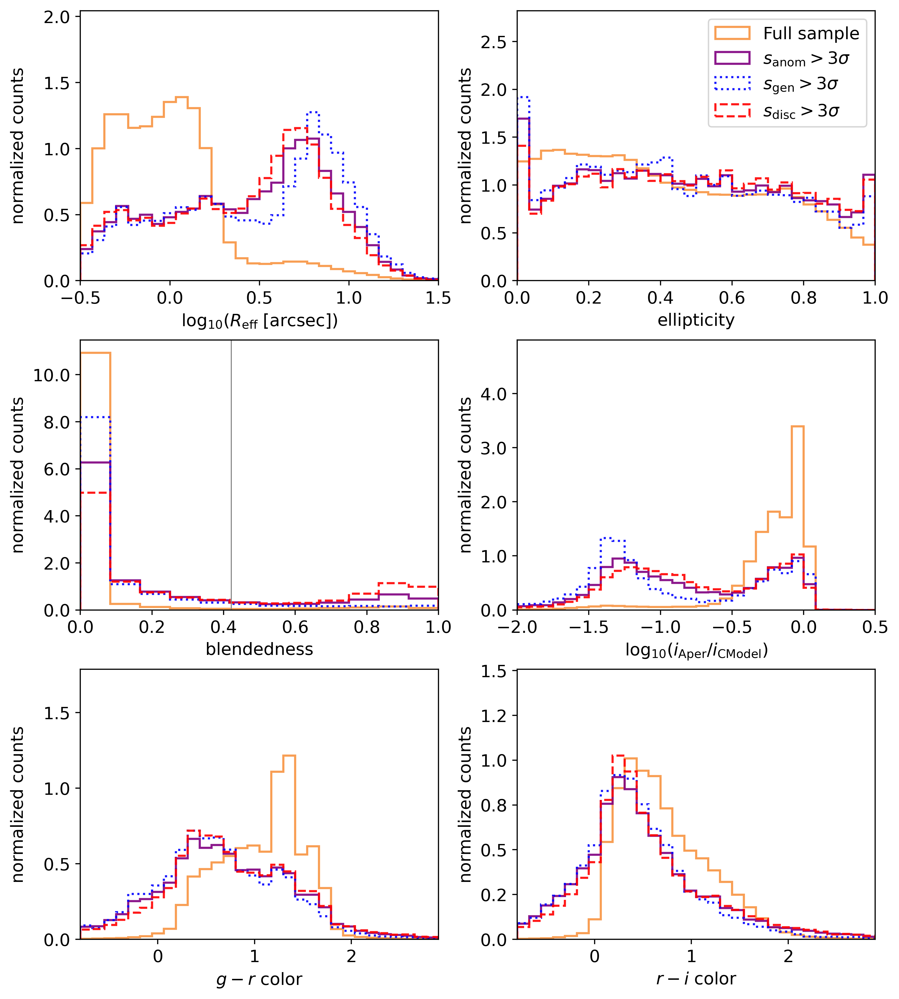

In [40]:
nrows = 3
ncols = 2

saveto = f'{plot_dir}/hsc_histograms.png'
fig, axarr = plt.subplots(nrows, ncols, figsize=(5*ncols, 4*nrows))
plt.subplots_adjust(hspace=0.22, wspace=0.22)

plot_histogram(axarr[0][0], 'i_cmodel_exp_ellipse_logr', anom_cats, anom_colors, anom_labels, anom_lss)
plot_histogram(axarr[0][1], 'i_cmodel_exp_ellipse_e', anom_cats, anom_colors, anom_labels, anom_lss, legend=True)

plot_histogram(axarr[1][0], 'i_blendedness_abs_flux', anom_cats, anom_colors, anom_labels, anom_lss)
plot_histogram(axarr[1][1], 'i_aperature_ratio', anom_cats, anom_colors, anom_labels, anom_lss)

plot_histogram(axarr[2][0], 'gr_color_cmod', anom_cats, anom_colors, anom_labels, anom_lss)
plot_histogram(axarr[2][1], 'ri_color_cmod', anom_cats, anom_colors, anom_labels, anom_lss)

fig.align_ylabels()

plt.savefig(saveto, bbox_inches='tight')

In [46]:
print(f"median full log(reff): {np.nanmedian(anom_cat['i_cmodel_exp_ellipse_logr'])}")
print(f"median full reff: {10**np.nanmedian(anom_cat['i_cmodel_exp_ellipse_logr'])}")
print(f"median disc log(reff): {np.nanmedian(anom_disc['i_cmodel_exp_ellipse_logr'])}")
print(f"median disc reff: {10**np.nanmedian(anom_disc['i_cmodel_exp_ellipse_logr'])}")

median full log(reff): -0.27107595194491685
median full reff: 0.5357029624708081
median disc log(reff): 0.39688787549049376
median disc reff: 2.493950765026977


In [50]:
blend_mask_full = np.where(anom_cat['i_blendedness_abs_flux']>10**(-0.375))[0]
blend_mask_disc = np.where(anom_disc['i_blendedness_abs_flux']>10**(-0.375))[0]
print(f"% full above blend thresh: {len(blend_mask_full)/len(anom_cat)}")
print(f"% disc above blend thresh: {len(blend_mask_disc)/len(anom_disc)}")

% full above blend thresh: 0.046506028441387764
% disc above blend thresh: 0.31928470727906805


## Score effects figure

In [14]:
imdict_fn = f'{base_dir}/data/idxdicts_h5/idx2imloc_gri.npy'
idx2imloc = np.load(imdict_fn, allow_pickle=True).item()
imarr_fn = f'{base_dir}/data/images_h5/images_gri.h5'
imarr = h5py.File(imarr_fn, 'r')

In [15]:
def plot_ims_tight(ax_grid, ids, nrows, ncols):
    NSIDE = 96
    NBANDS = 3
    imgrid = np.empty((nrows*NSIDE, ncols*NSIDE, NBANDS))
    count = 0
    for i in range(nrows):
        for j in range(ncols):
            idx = ids[count]
            loc = idx2imloc[idx]
            im = imarr['images'][loc]
            im = utils.luptonize(im)
            
            imgrid[i*NSIDE:(i+1)*NSIDE, j*NSIDE:(j+1)*NSIDE, :] = im
            count += 1
    imgrid = imgrid.astype('int32')
    ax_grid.imshow(imgrid)

In [16]:
nrows = 6
ncols = 6
nplot = nrows*ncols

nrows_small = 3
ncols_small = 3
nplot_small = nrows_small*ncols_small

In [17]:
idxs_sub = anom_gen['idx']
print(len(idxs_sub))
np.random.seed(8) # 8
idxs_gen = np.random.choice(idxs_sub, nplot, replace=False)

idxs_sub = anom_disc['idx']
print(len(idxs_sub))
np.random.seed(8) # 8
idxs_disc = np.random.choice(idxs_sub, nplot, replace=False)

idxs_sub = anom_comb['idx']
print(len(idxs_sub))
np.random.seed(8) # 8
idxs_comb = np.random.choice(idxs_sub, nplot, replace=False)

# scomb
anom_comb_lowd = anom_cat[mask_comb & ~mask_disc]
idxs_sub = anom_comb_lowd['idx']
print(len(idxs_sub))
np.random.seed(8) # 8
idxs_comb_lowd = np.random.choice(idxs_sub, nplot_small, replace=False)

anom_comb_lowg = anom_cat[mask_comb & ~mask_gen]
idxs_sub = anom_comb_lowg['idx']
print(len(idxs_sub))
np.random.seed(8) # 8
idxs_comb_lowg = np.random.choice(idxs_sub, nplot_small, replace=False)

# sdisc
anom_disc_lowc = anom_cat[mask_disc & ~mask_comb]
idxs_sub = anom_disc_lowc['idx']
print(len(idxs_sub))
np.random.seed(8) # 8
idxs_disc_lowc = np.random.choice(idxs_sub, nplot_small, replace=False)

anom_disc_lowg = anom_cat[mask_disc & ~mask_gen]
idxs_sub = anom_disc_lowg['idx']
print(len(idxs_sub))
np.random.seed(8) # 8
idxs_disc_lowg = np.random.choice(idxs_sub, nplot_small, replace=False)

# sgen
anom_gen_lowc = anom_cat[mask_gen & ~mask_comb]
idxs_sub = anom_gen_lowc['idx']
print(len(idxs_sub))
np.random.seed(8) # 8
idxs_gen_lowc = np.random.choice(idxs_sub, nplot_small, replace=False)

anom_gen_lowd = anom_cat[mask_gen & ~mask_disc]
idxs_sub = anom_gen_lowd['idx']
print(len(idxs_sub))
np.random.seed(8) # 8
idxs_gen_lowd = np.random.choice(idxs_sub, nplot_small, replace=False)

11528
13477
11559
2145
4702
4063
8608
4671
6659


In [41]:
print(f"n sdisc>3sigma: {len(anom_disc)}")
print(f"% sdisc>3sigma/total: {len(anom_disc)/len(anom_cat)}")

n sdisc>3sigma: 13477
% sdisc>3sigma/total: 0.014294942303673917


In [18]:
lcl = r'$s_\mathrm{anom} < 3\sigma$'
ldl = r'$s_\mathrm{disc} < 3\sigma$'
lgl = r'$s_\mathrm{gen} < 3\sigma$'

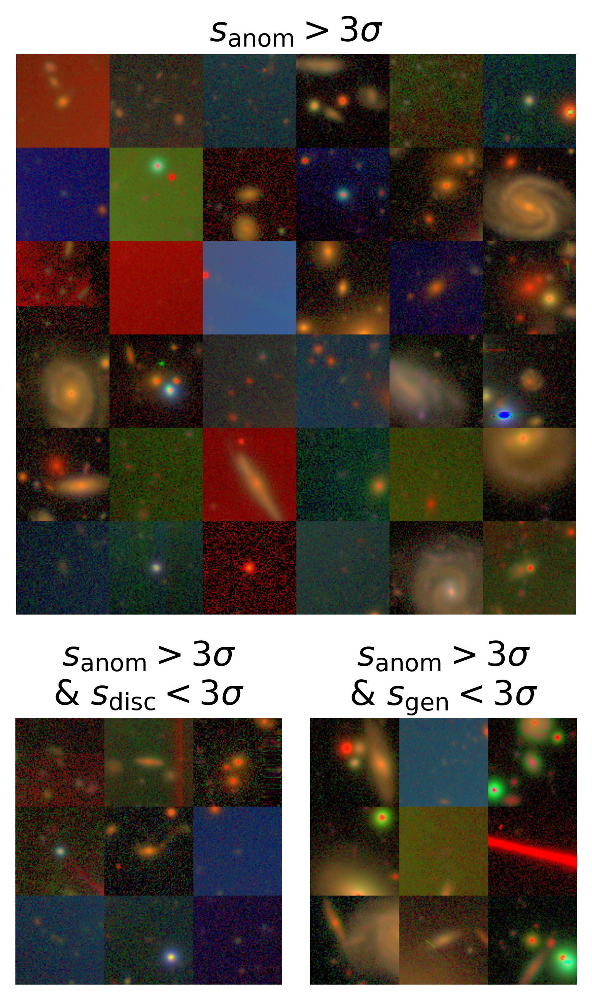

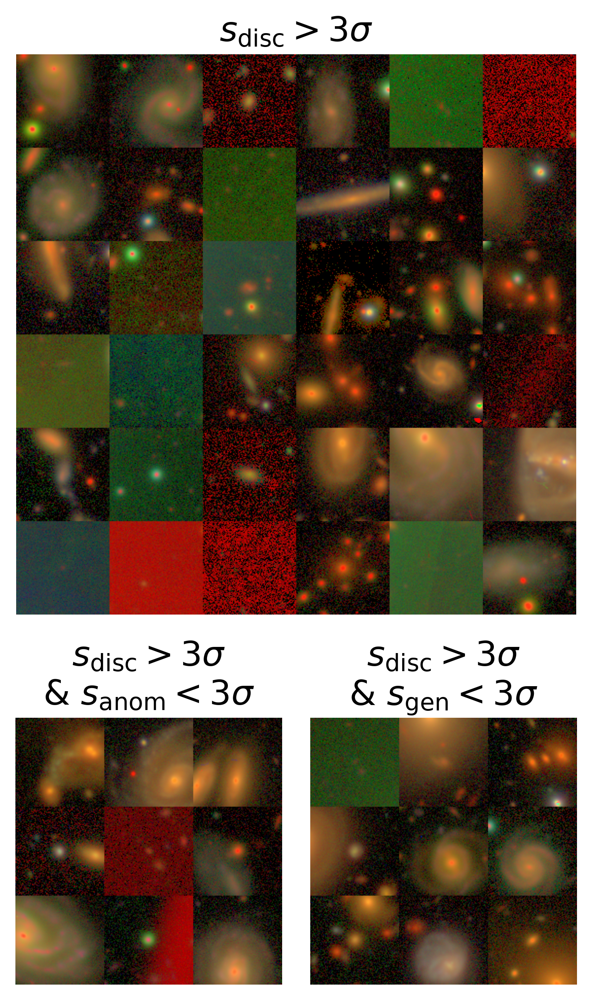

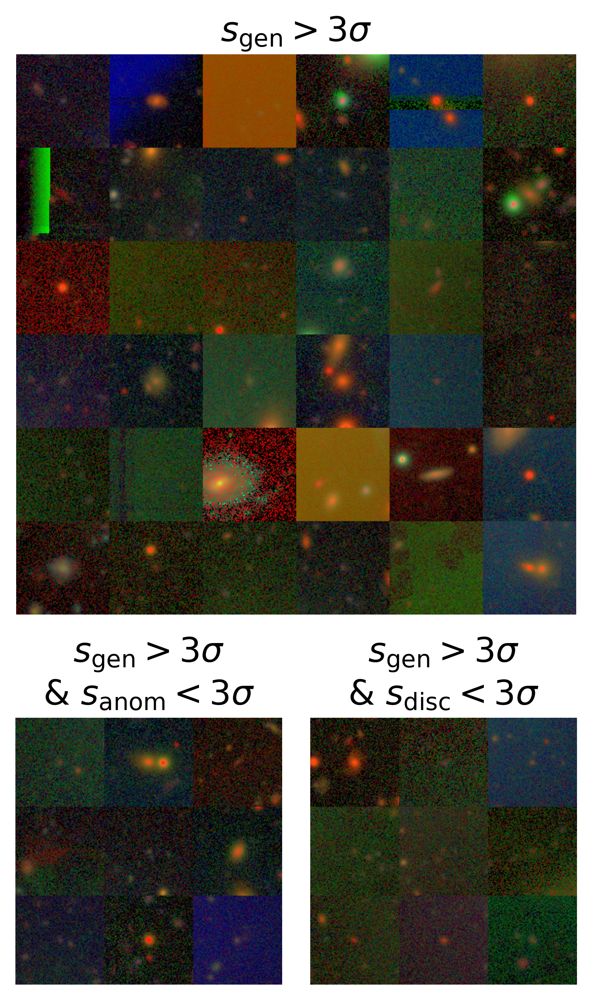

In [19]:
fs_title = 16

### s_comb panels
saveto = f'{plot_dir}/score_effect_comb.png'
fig = plt.figure(constrained_layout=False, figsize=(6,8))
gs = fig.add_gridspec(2, 2, wspace=-0.3, hspace=0.25, height_ratios=[2.1,1])

ax0 = fig.add_subplot(gs[0, :])
ax0a = fig.add_subplot(gs[1, 0])
ax0b = fig.add_subplot(gs[1, 1])

plot_ims_tight(ax0, idxs_comb, nrows, ncols)
plot_ims_tight(ax0a, idxs_comb_lowd, nrows_small, ncols_small)
plot_ims_tight(ax0b, idxs_comb_lowg, nrows_small, ncols_small)

ax0.set_title(lc, fontsize=fs_title)
ax0a.set_title(f'{lc}\n& {ldl}', fontsize=fs_title)
ax0b.set_title(f'{lc}\n& {lgl}', fontsize=fs_title)

# turn off all axes
for ax in fig.get_axes():
    ax.set_xticks([])
    ax.set_yticks([])
    ax.axis("off")
plt.savefig(saveto, bbox_inches='tight')

### s_disc panels
saveto = f'{plot_dir}/score_effect_disc.png'
fig = plt.figure(constrained_layout=False, figsize=(6,8))
gs = fig.add_gridspec(2, 2, wspace=-0.3, hspace=0.25, height_ratios=[2.1,1])

ax1 = fig.add_subplot(gs[0, :])
ax1a = fig.add_subplot(gs[1, 0])
ax1b = fig.add_subplot(gs[1, 1])

plot_ims_tight(ax1, idxs_disc, nrows, ncols)
plot_ims_tight(ax1a, idxs_disc_lowc, nrows_small, ncols_small)
plot_ims_tight(ax1b, idxs_disc_lowg, nrows_small, ncols_small)

ax1.set_title(ld, fontsize=fs_title)
ax1a.set_title(f'{ld}\n& {lcl}', fontsize=fs_title)
ax1b.set_title(f'{ld}\n& {lgl}', fontsize=fs_title)

# turn off all axes
for ax in fig.get_axes():
    ax.set_xticks([])
    ax.set_yticks([])
    ax.axis("off")
plt.savefig(saveto, bbox_inches='tight')
    
### s_gen panels
saveto = f'{plot_dir}/score_effect_gen.png'
fig = plt.figure(constrained_layout=False, figsize=(6,8))
gs = fig.add_gridspec(2, 2, wspace=-0.3, hspace=0.25, height_ratios=[2.1,1])

ax2 = fig.add_subplot(gs[0, :])
ax2a = fig.add_subplot(gs[1, 0])
ax2b = fig.add_subplot(gs[1, 1])

plot_ims_tight(ax2, idxs_gen, nrows, ncols)
plot_ims_tight(ax2a, idxs_gen_lowc, nrows_small, ncols_small)
plot_ims_tight(ax2b, idxs_gen_lowd, nrows_small, ncols_small)

ax2.set_title(lg, fontsize=fs_title)
ax2a.set_title(f'{lg}\n& {lcl}', fontsize=fs_title)
ax2b.set_title(f'{lg}\n& {ldl}', fontsize=fs_title)

# turn off all axes
for ax in fig.get_axes():
    ax.set_xticks([])
    ax.set_yticks([])
    ax.axis("off")
plt.savefig(saveto, bbox_inches='tight')

## UMAPs (100k)

In [20]:
embed_dir = f"{base_dir}/results/embeddings"

tag_u = 'gri_100k_lambda0.3'
umap_tag = '_nn5md0.1'

results_fn_u = f'{base_dir}/results/results_{tag_u}.h5'
res_u = h5py.File(results_fn_u, 'r')
scores_u = res_u['disc_scores_sigma']

<AxesSubplot:>

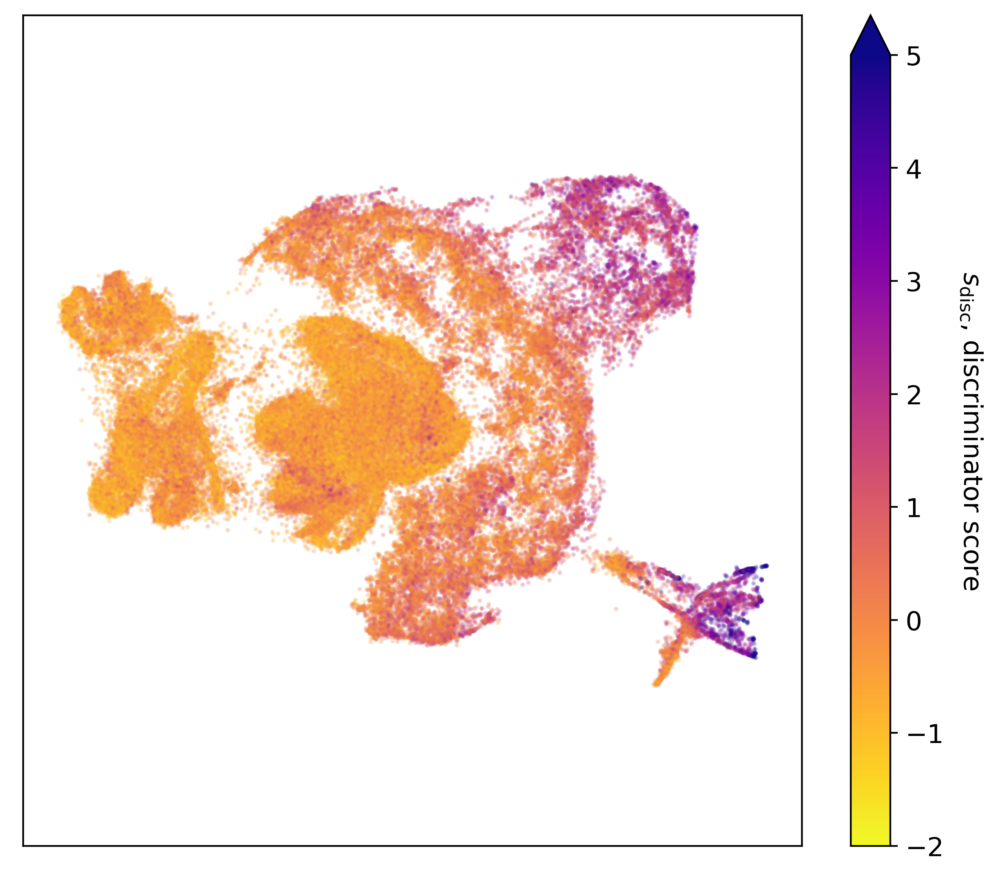

In [21]:
embedding = np.load(f"{embed_dir}/embedding_umap_reals_{tag_u}{umap_tag}.npy")
saveto = f'{plot_dir}/umap_{tag_u}_reals.png'
plotter.plot_umap(embedding, colorby=scores_u, vmin=-2, vmax=5, saveto=saveto)

<AxesSubplot:>

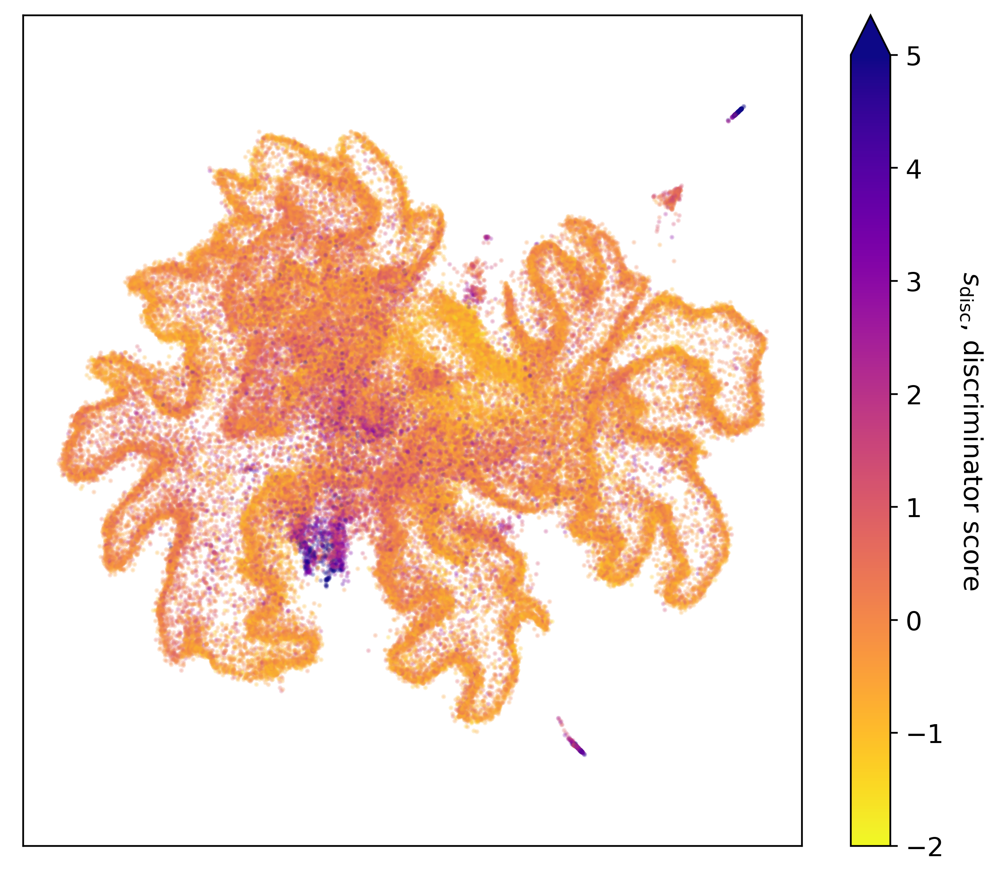

In [22]:
embedding = np.load(f"{embed_dir}/embedding_umap_residuals_{tag_u}{umap_tag}.npy")
saveto = f'{plot_dir}/umap_{tag_u}_resids.png'
plotter.plot_umap(embedding, colorby=scores_u, vmin=-2, vmax=5, saveto=saveto)

<AxesSubplot:>

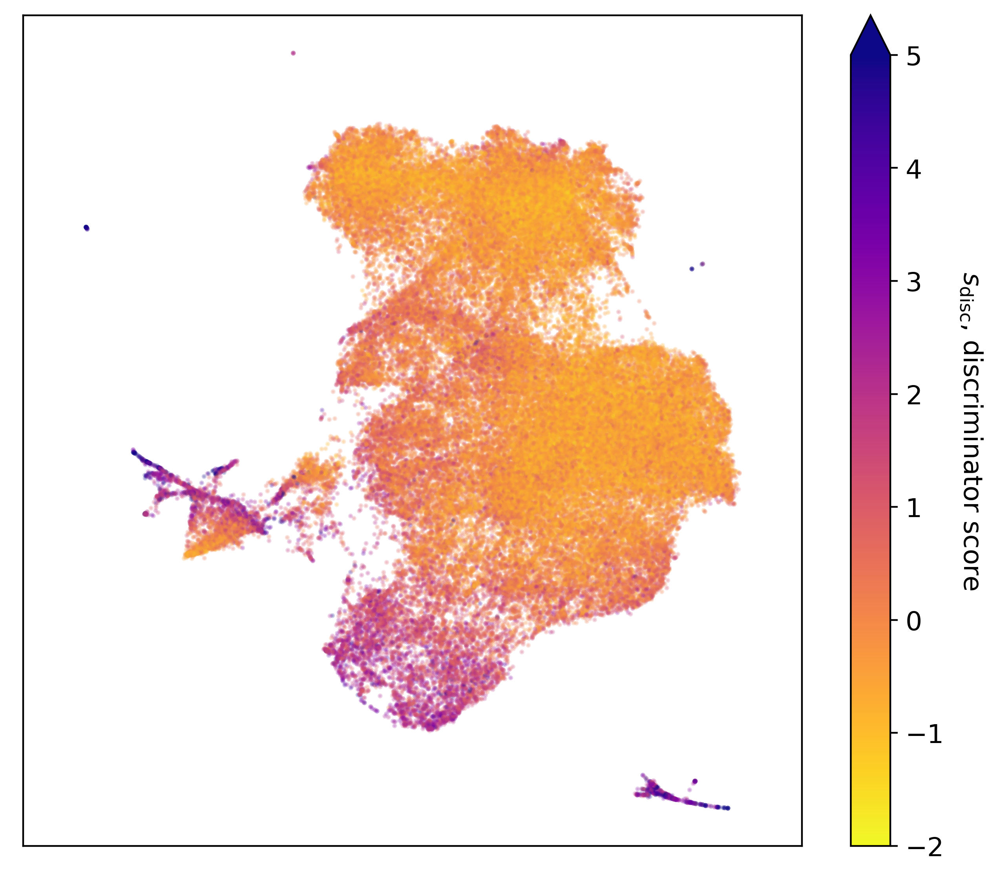

In [23]:
auto_tag = '_model30000_latent64_reals_long'
embedding = np.load(f"{embed_dir}/embedding_umap_auto_{tag_u}{auto_tag}{umap_tag}.npy", allow_pickle=True)
saveto = f'{plot_dir}/umap_{tag_u}_reals_auto.png'
plotter.plot_umap(embedding, colorby=scores_u, vmin=-2, vmax=5,  saveto=saveto)

<AxesSubplot:>

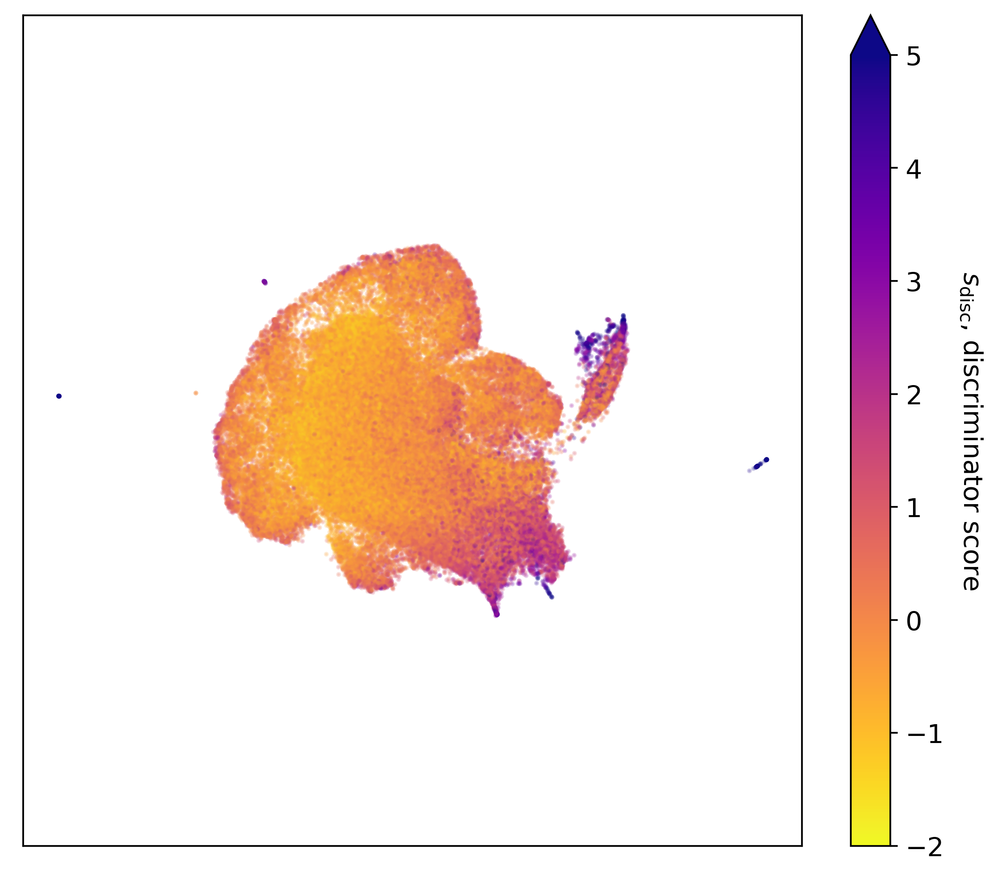

In [24]:
auto_tag = '_model30000_latent64_residuals_long'
embedding = np.load(f"{embed_dir}/embedding_umap_auto_{tag_u}{auto_tag}{umap_tag}.npy", allow_pickle=True)
saveto = f'{plot_dir}/umap_{tag_u}_resids_auto.png'
plotter.plot_umap(embedding, colorby=scores_u, vmin=-2, vmax=5,  saveto=saveto)

## UMAP 3sigd, boxes

In [25]:
import matplotlib.colors as colors
def truncate_colormap(cmap, minval=0.0, maxval=1.0, n=100):
    new_cmap = colors.LinearSegmentedColormap.from_list(
        'trunc({n},{a:.2f},{b:.2f})'.format(n=cmap.name, a=minval, b=maxval),
        cmap(np.linspace(minval, maxval, n)))
    return new_cmap

cmap = plt.get_cmap('Purples')
cmap_purp = truncate_colormap(cmap, 0.25, 1.0)

In [26]:
embed_dir = f"{base_dir}/results/embeddings"

tag_u = 'gri_lambda0.3_3sigd'
umap_tag = '_nn5md0.1'
auto_tag = '_model30000_latent64_residuals_long'

results_fn_u = f'{base_dir}/results/results_{tag_u}.h5'
res_u = h5py.File(results_fn_u, 'r')
scores_u = res_u['disc_scores_sigma']

/scratch/ksf293/anomalies/results/embeddings/embedding_umap_auto_gri_lambda0.3_3sigd_model30000_latent64_residuals_long_nn5md0.1.npy


<AxesSubplot:xlabel='umap A', ylabel='umap B'>

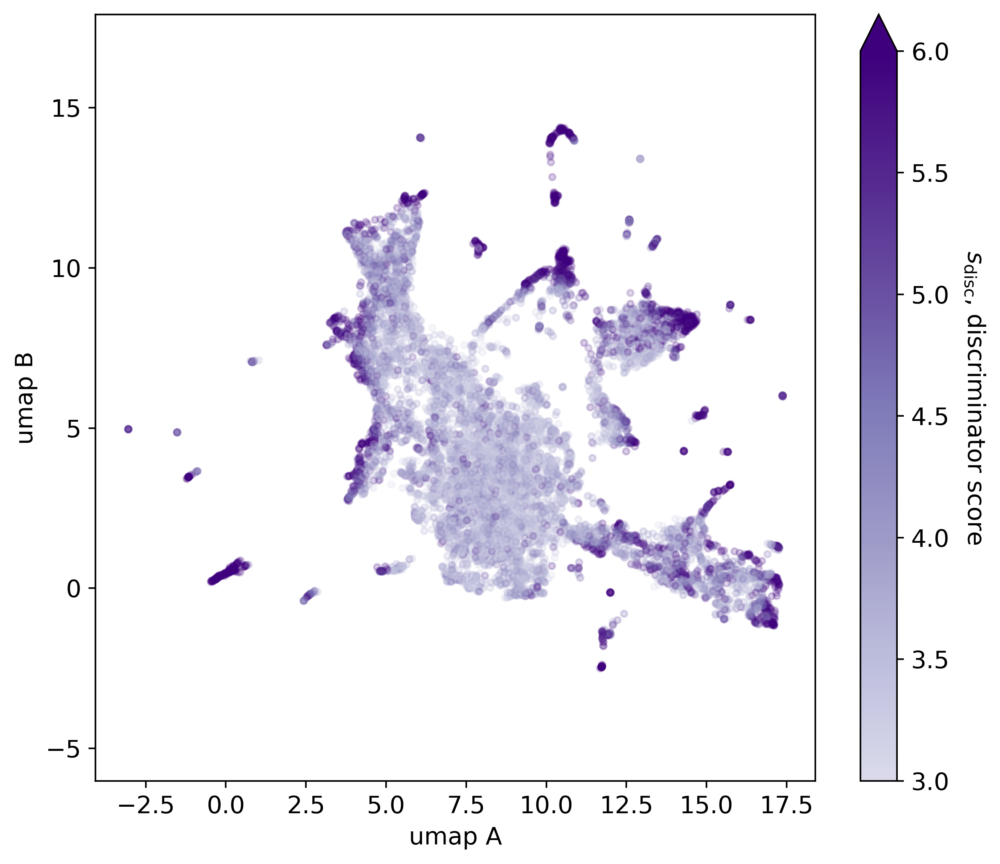

In [27]:
embed_fn = f"{embed_dir}/embedding_umap_auto_{tag_u}{auto_tag}{umap_tag}.npy"
print(embed_fn)
embedding_3sigdisc_auto_resid = np.load(embed_fn, allow_pickle=True)
saveto = None
plotter.plot_umap(embedding_3sigdisc_auto_resid, colorby=scores_u, cmap=cmap_purp, vmin=3, vmax=6, s=40, 
                  saveto=saveto, show_axes=True)

In [28]:
n_ims = 5

24


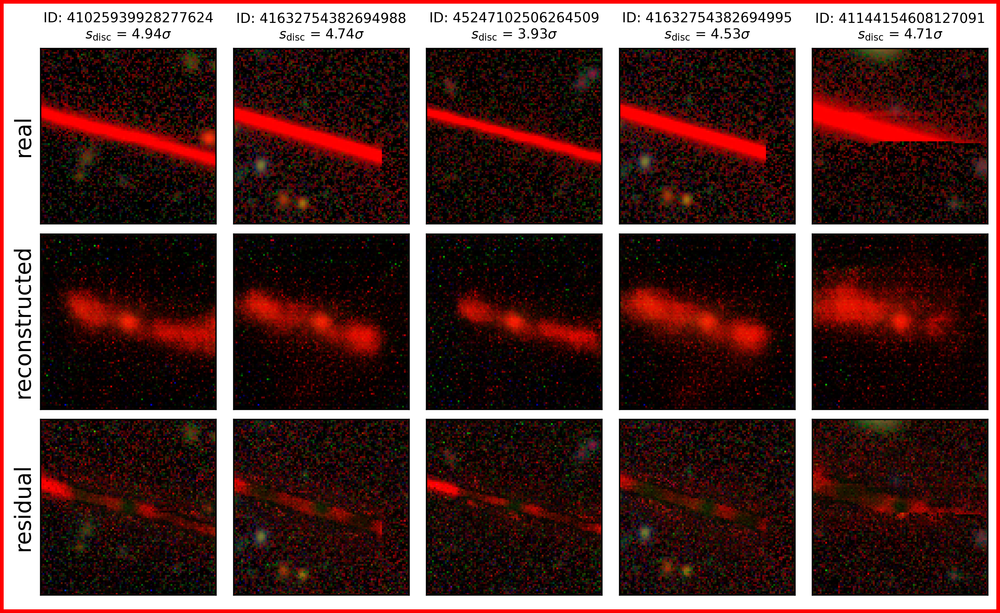

In [29]:
box_red = [2.5,3,-0.5,0]
bcolor_red = 'red'
idxs_box = utils.get_idxs_in_box(embedding_3sigdisc_auto_resid, box_red, n_ims, seed=42) #39
saveto = f'{plot_dir}/recons_box_{bcolor_red}.png'
imtag = 'gri'
restag = 'gri_lambda0.3'
plotter.plot_recons(idxs_box, imtag, restag, border_color=bcolor_red, saveto=saveto)

44


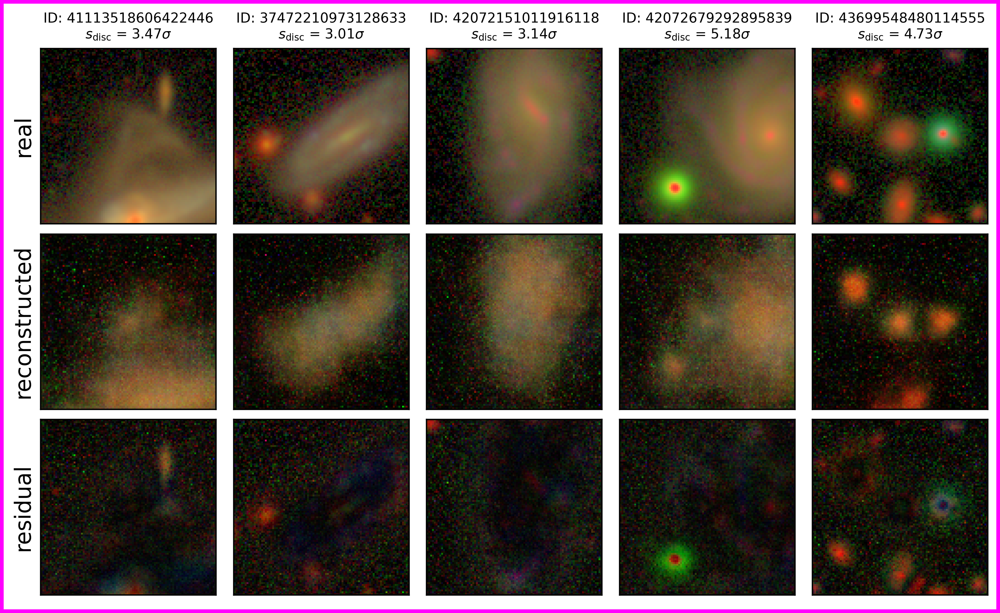

In [30]:
box_center = [7.5,8,5.75,6.25]
bcolor_center = 'magenta'
idxs_box = utils.get_idxs_in_box(embedding_3sigdisc_auto_resid, box_center, n_ims, seed=49) #49, 42
saveto = f'{plot_dir}/recons_box_{bcolor_center}.png'
imtag = 'gri'
restag = 'gri_lambda0.3'
plotter.plot_recons(idxs_box, imtag, restag, border_color=bcolor_center, saveto=saveto)

20


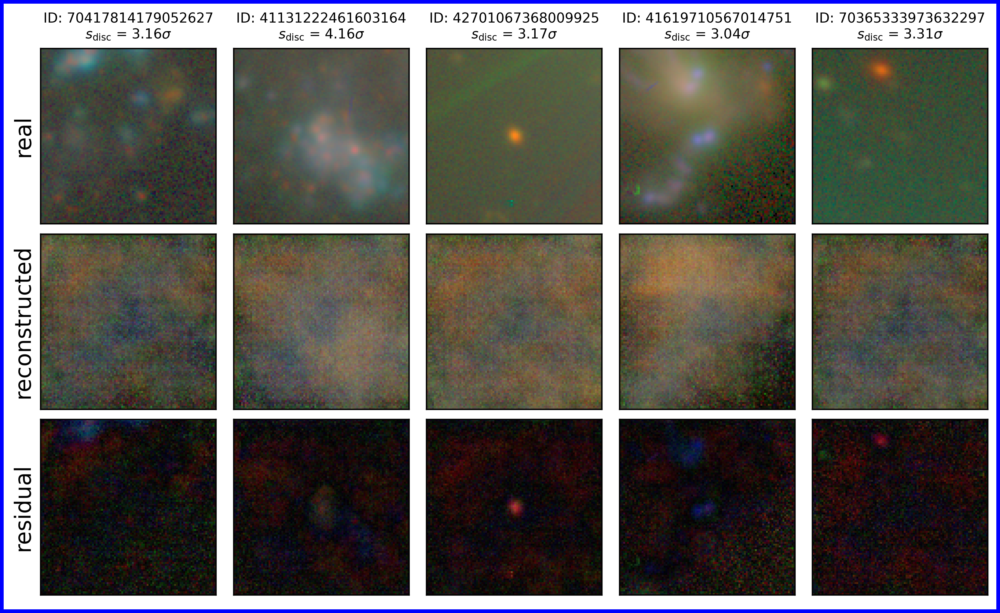

In [31]:
box_right = [13.75, 14.25, 1.75, 2.25]
bcolor_right = 'blue'
idxs_box = utils.get_idxs_in_box(embedding_3sigdisc_auto_resid, box_right, n_ims, seed=21) # 21!! 41, 43, 48, 40, 28, 25, 24
saveto = f'{plot_dir}/recons_box_{bcolor_right}.png'
imtag = 'gri'
restag = 'gri_lambda0.3'
plotter.plot_recons(idxs_box, imtag, restag, border_color=bcolor_right, saveto=saveto)

48


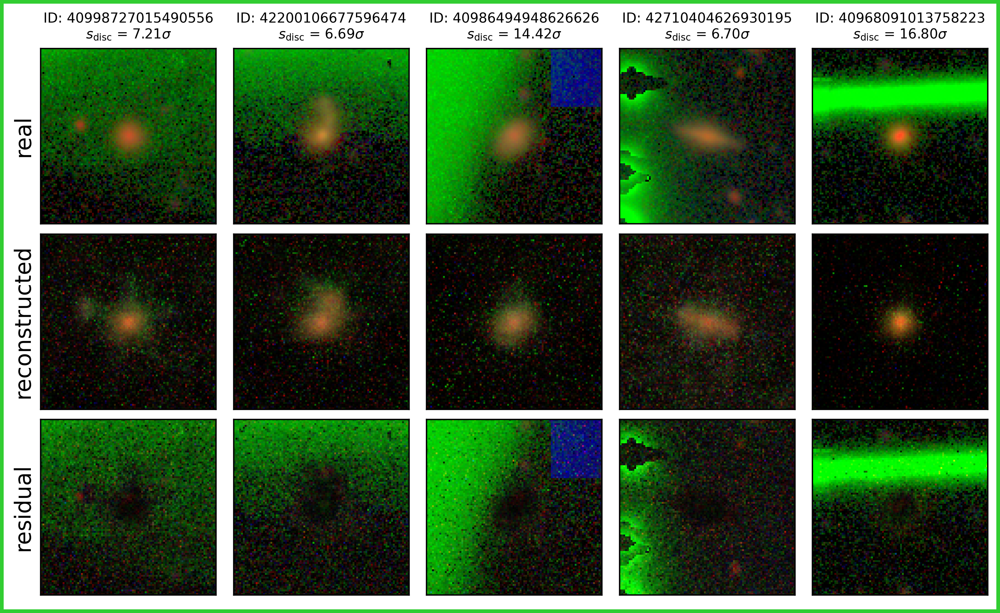

In [32]:
box_green = [11.5,12,-1.75,-1.25]
bcolor_green = 'limegreen'
idxs_box = utils.get_idxs_in_box(embedding_3sigdisc_auto_resid, box_green, n_ims, seed=42) #42
saveto = f'{plot_dir}/recons_box_{bcolor_green}.png'
imtag = 'gri'
restag = 'gri_lambda0.3'
plotter.plot_recons(idxs_box, imtag, restag, border_color=bcolor_green, saveto=saveto)

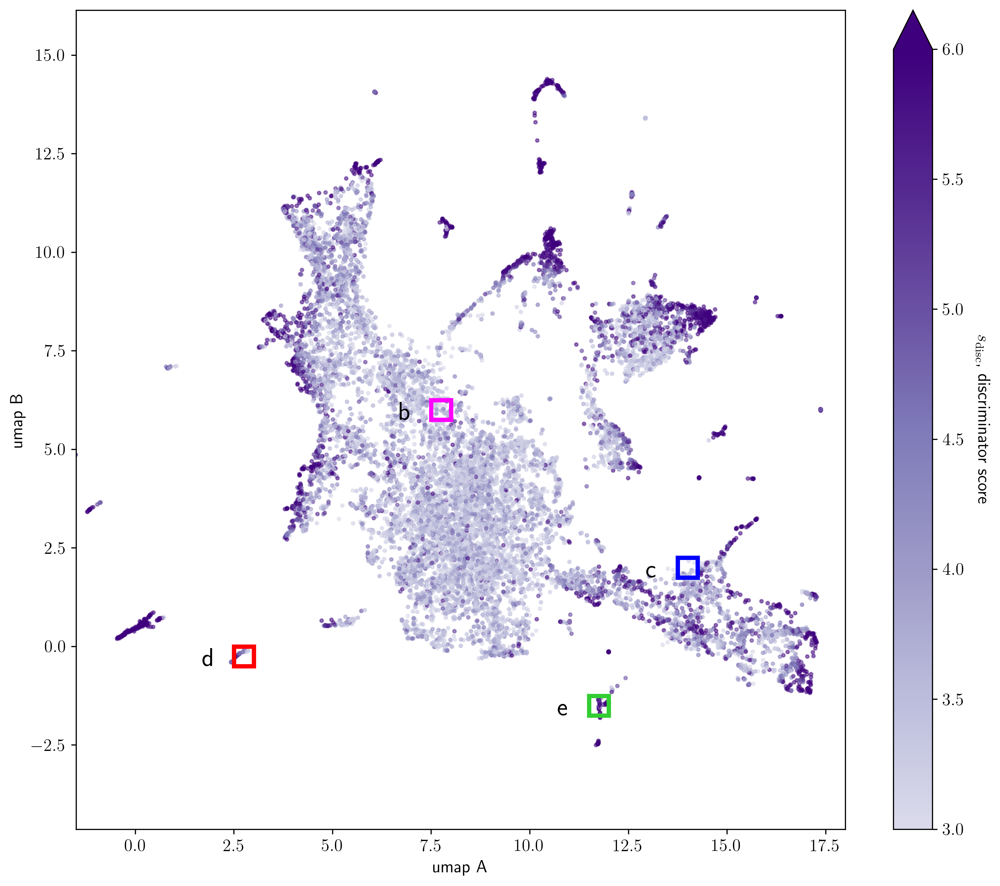

In [43]:
boxes = [box_center, box_right, box_red, box_green]
bcolors = [bcolor_center, bcolor_right, bcolor_red, bcolor_green]
blabels = ['b', 'c', 'd', 'e']
saveto = f'{plot_dir}/umap_3sigd_auto_resids_boxes.png'
ax = plotter.plot_umap(embedding_3sigdisc_auto_resid, boxes=boxes, box_colors=bcolors, box_labels=blabels,
                       cmap=cmap_purp, figsize=(12,10.5), alpha=0.5, s=20, xlim=[-1.5,18], ylim=[-4,15.5], 
                       saveto=saveto, vmin=3, vmax=6, show_axes=True) # turn axes off bore saving final

# Reconstructions by score

In [34]:
imtag = 'gri'
tag = 'gri_lambda0.3'
results_fn = f'{base_dir}/results/results_{tag}.h5'
res = h5py.File(results_fn, 'r')
scores = res['anomaly_scores_sigma'][:]
idxs = res['idxs'][:]
n_recons = 3

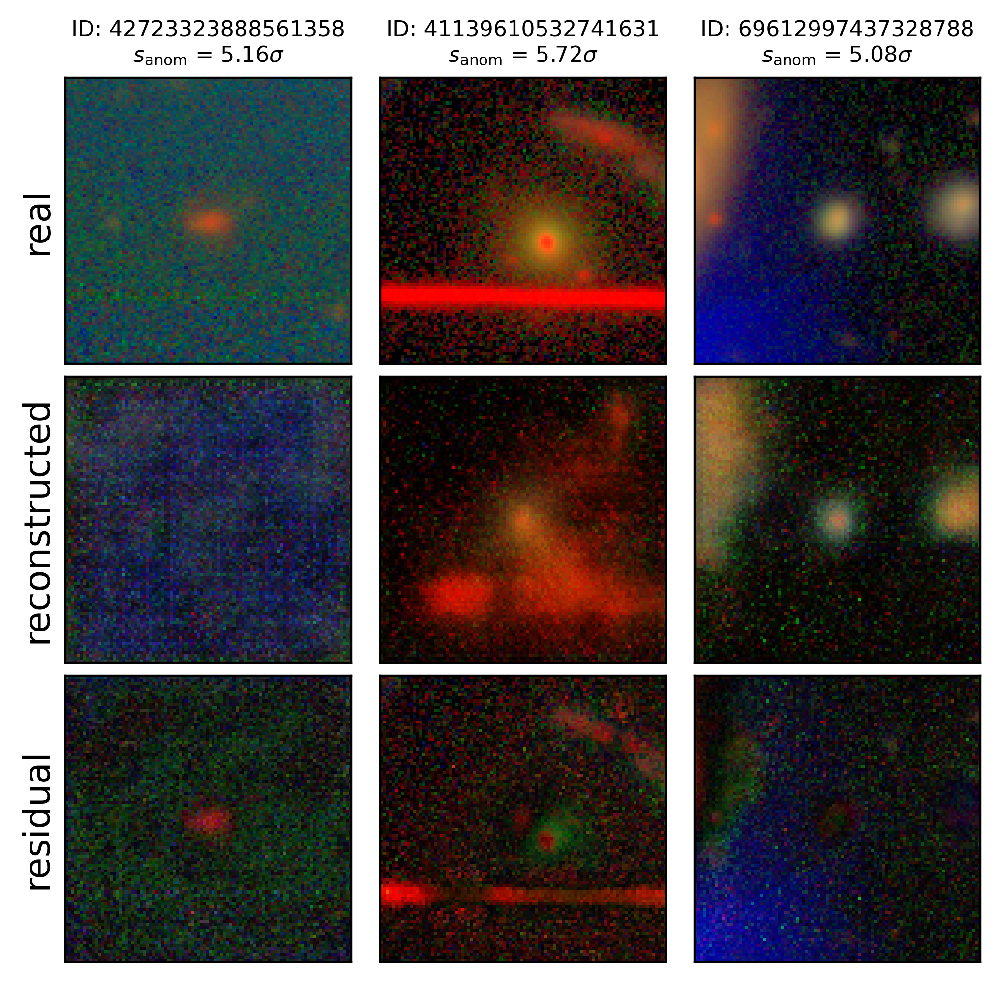

In [35]:
smin, smax = 5, 20
np.random.seed(43) #41
indices = np.where((scores >= smin) & (scores < smax))[0]
indices_n = np.random.choice(indices, n_recons)
idxs_recon = idxs[indices_n]
plotter.plot_recons(idxs_recon, imtag, tag, saveto=f'{plot_dir}/recons_{smin}to{smax}sigcomb.png',
                    score_name='anomaly_scores_sigma', score_label='$s_\mathrm{{anom}}$')

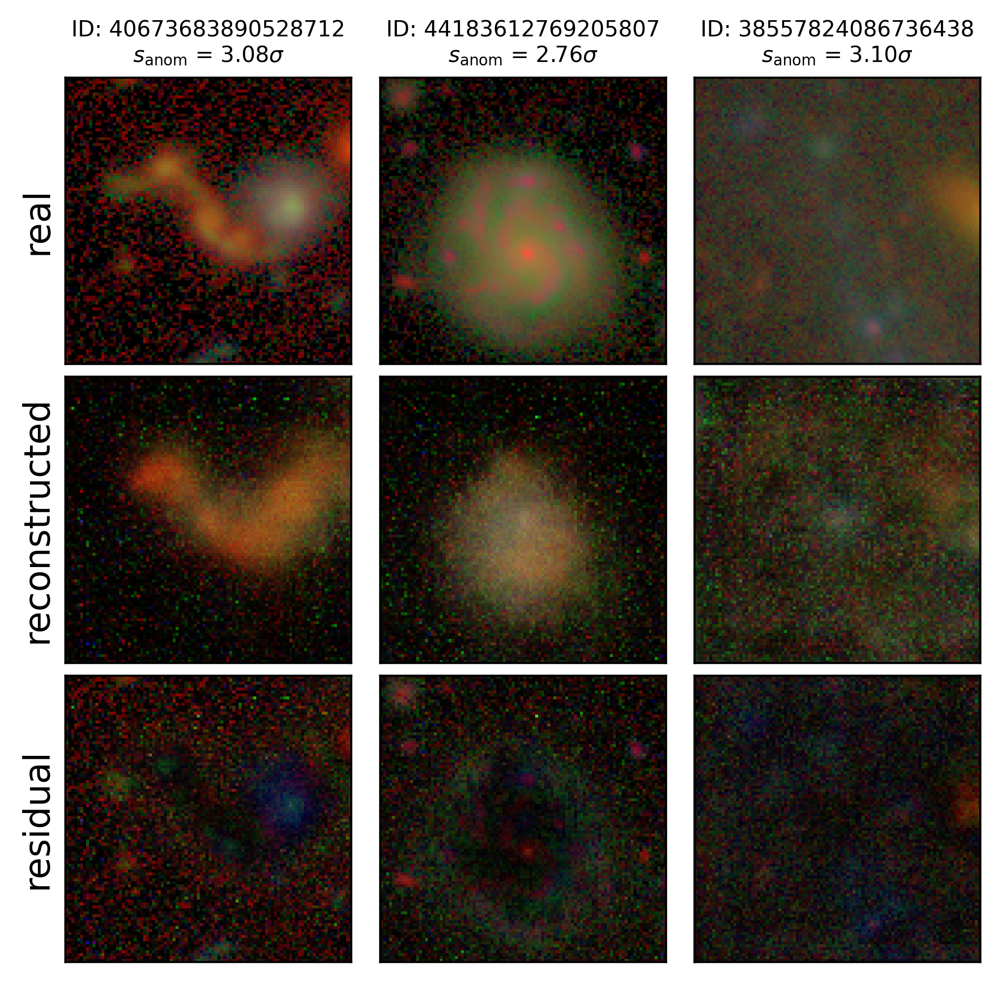

In [36]:
smin, smax = 2.5,3.5
np.random.seed(42)
indices = np.where((scores >= smin) & (scores < smax))[0] #43, 45, 39
indices_n = np.random.choice(indices, n_recons)
idxs_recon = idxs[indices_n]
plotter.plot_recons(idxs_recon, imtag, tag, saveto=f'{plot_dir}/recons_{smin}to{smax}sigcomb.png',
                    score_name='anomaly_scores_sigma', score_label='$s_\mathrm{{anom}}$')

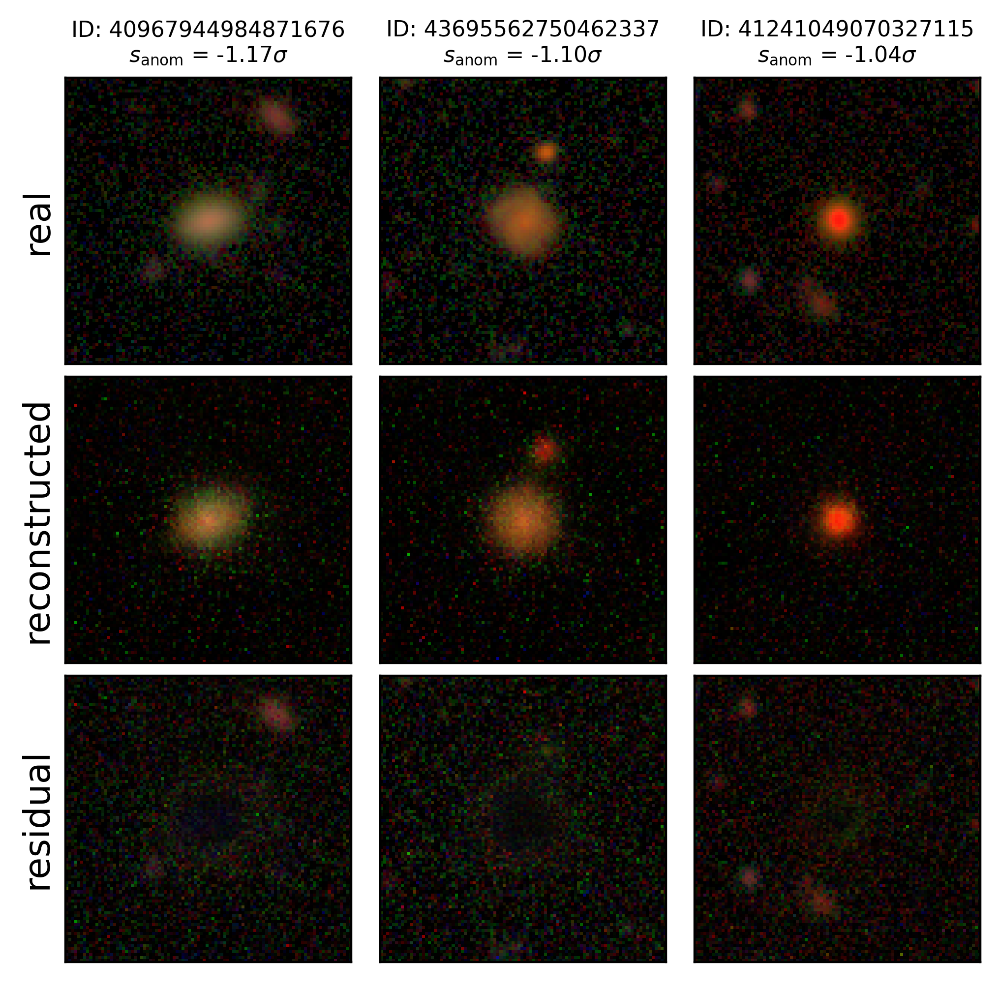

In [37]:
smin, smax = -3, -1
np.random.seed(41)
indices = np.where((scores >= smin) & (scores < smax))[0]
indices_n = np.random.choice(indices, n_recons)
idxs_recon = idxs[indices_n]
plotter.plot_recons(idxs_recon, imtag, tag, saveto=f'{plot_dir}/recons_{smin}to{smax}sigcomb.png',
                   score_name='anomaly_scores_sigma', score_label='$s_\mathrm{{anom}}$')

## detected anomalies

0.2 0.05


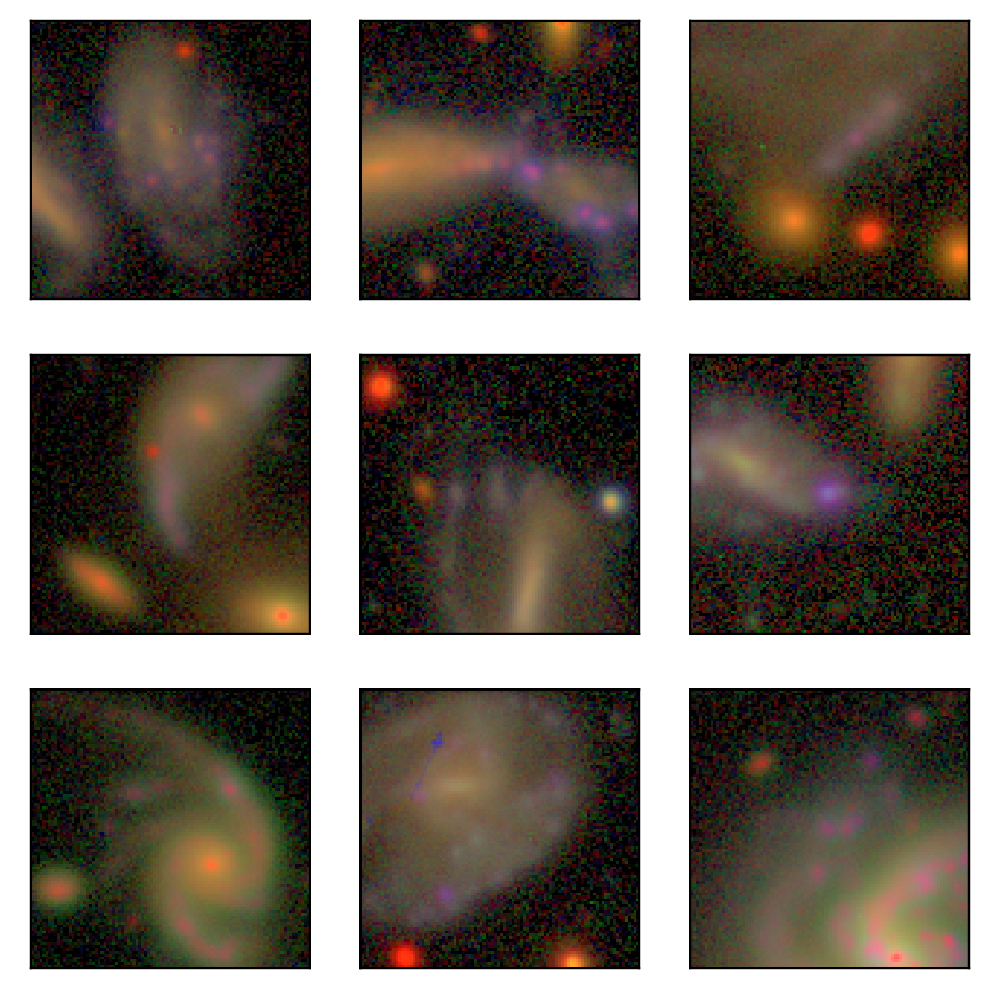

In [38]:
purple_ids = [631495, 60339, 105685, 80217, 378977, 355424, 690942, 726364, 477930]
saveto=f'{plot_dir}/anomalies_purple.png'
plotter.plot_ims(purple_ids, 3, 3, imtag='gri_lambda0.3_3sigd', saveto=saveto)

0.2 0.05


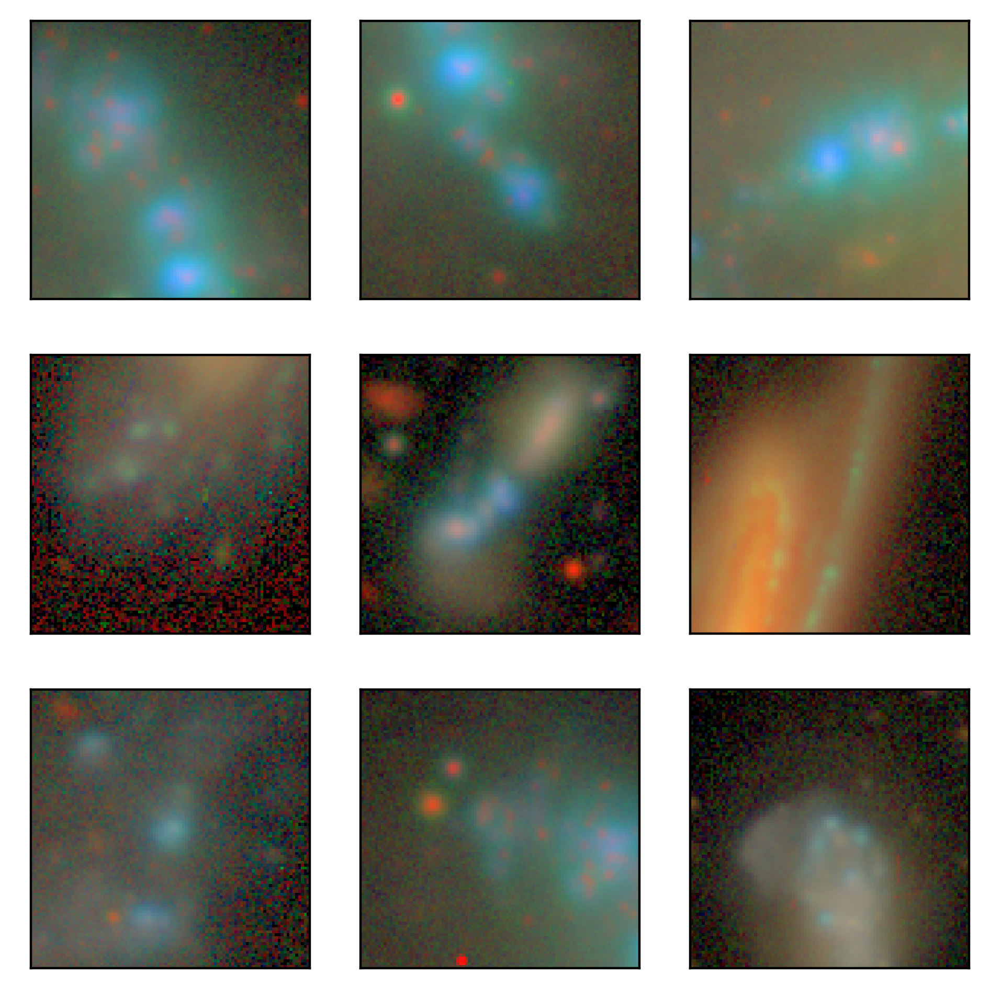

In [39]:
bluesf_ids = [461525, 461522, 702705, 402208, 86279, 27054, 207619, 461523, 554045] #54348 something close to that
saveto=f'{plot_dir}/anomalies_bluesf.png'
plotter.plot_ims(bluesf_ids, 3, 3, imtag='gri_lambda0.3_3sigd', saveto=saveto)

0.2 0.05


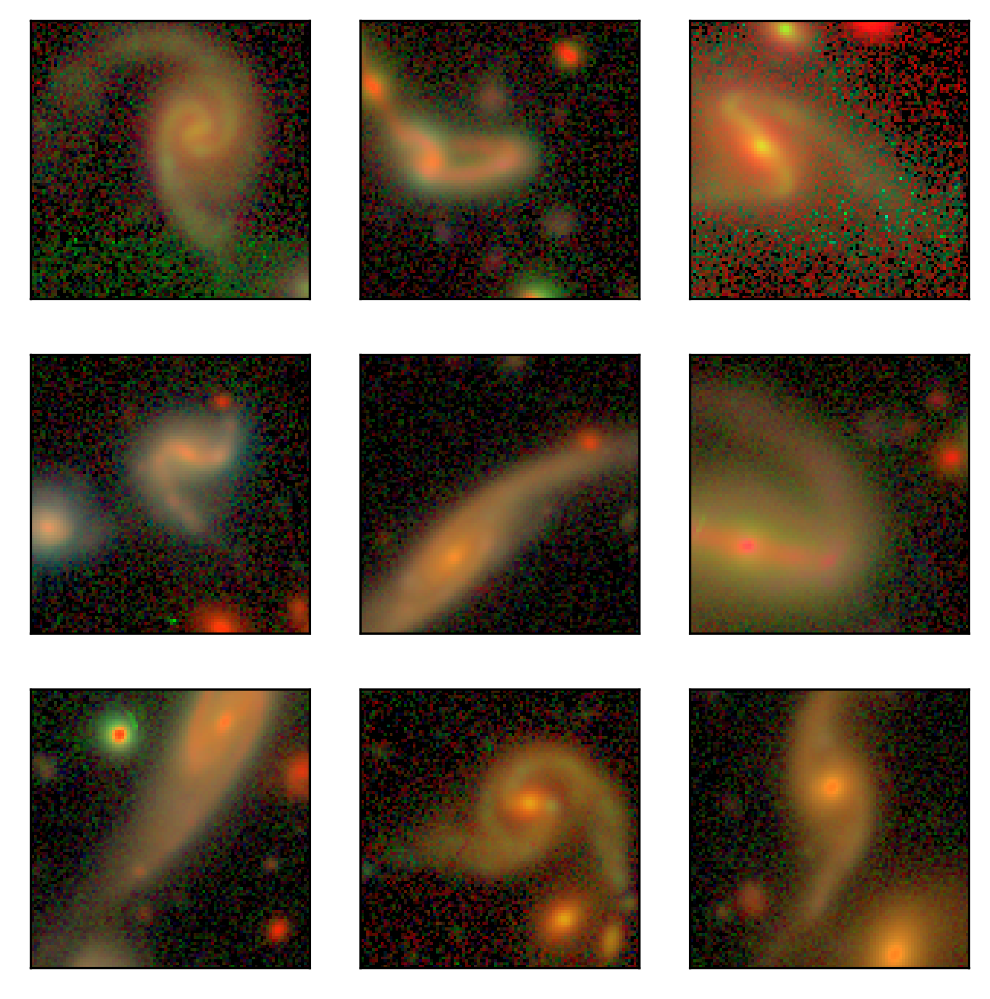

In [40]:
tidal_ids = [406992,232476,402855,112806, 771116, 116299, 193323, 357136, 734970] #390040, 526030
saveto=f'{plot_dir}/anomalies_tidal.png'
plotter.plot_ims(tidal_ids, 3, 3, imtag='gri_lambda0.3_3sigd', saveto=saveto)

0.2 0.05


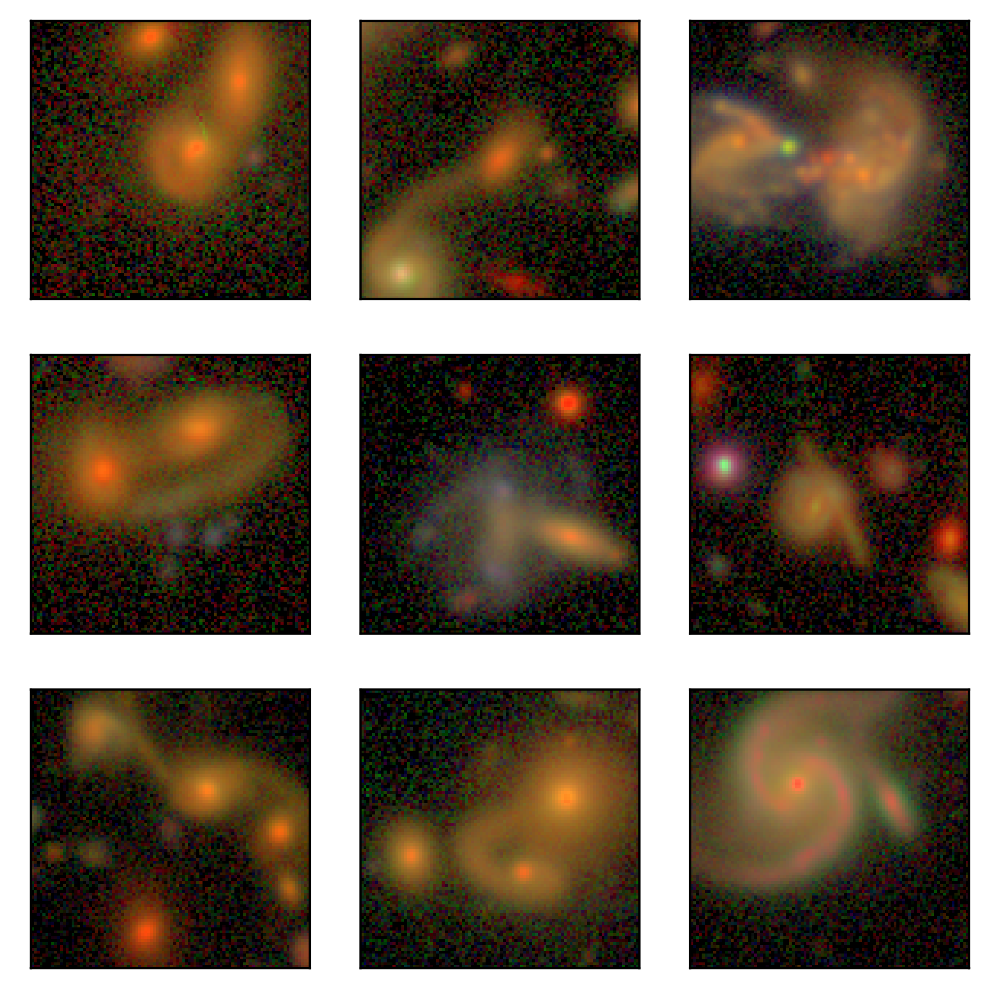

In [41]:
merger_ids = [147100,105162, 609137,275917, 273903, 331753, 476493, 516719, 864590]  #402153
saveto=f'{plot_dir}/anomalies_mergers.png'
plotter.plot_ims(merger_ids, 3, 3, imtag='gri_lambda0.3_3sigd', saveto=saveto)

0.2 0.05


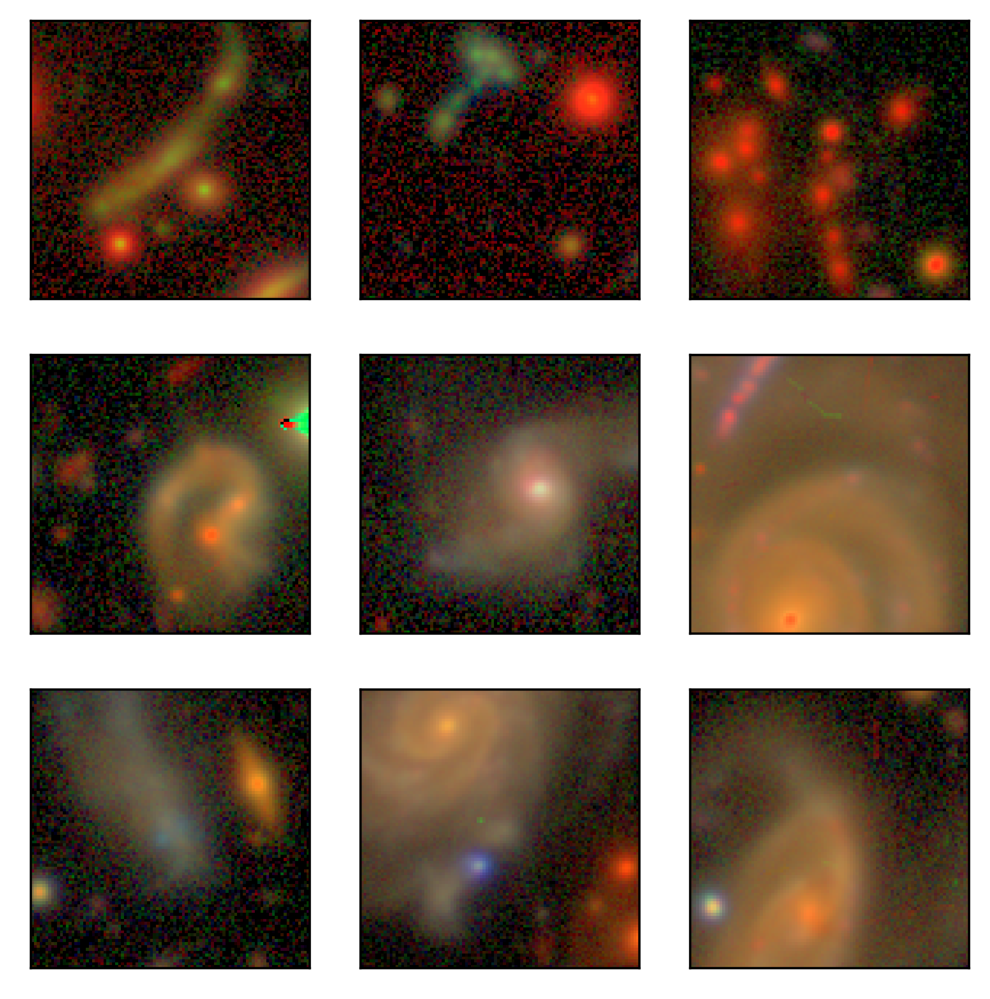

In [42]:
unknown_ids = [404340, 402594, 822595, 372063, 732308, 604860] #66001
bluecore_ids = [941128, 782291, 490258] #585702, 494887
saveto=f'{plot_dir}/anomalies_other.png'
plotter.plot_ims(unknown_ids + bluecore_ids, 3, 3, imtag='gri_lambda0.3_3sigd', saveto=saveto)

## Score distribution

-4.68004 25.4914 -1.0076863e-06 1.0
-2.290271 35.175587 1.5472738e-08 0.9999999


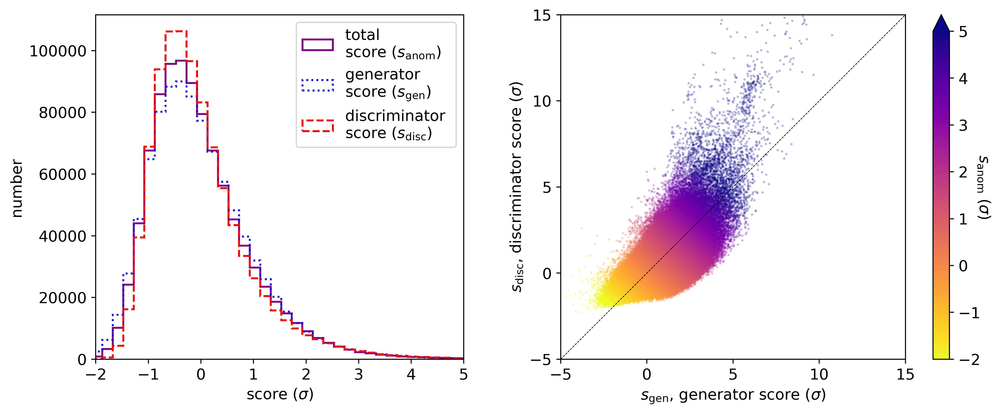

In [53]:
tag = 'gri_lambda0.3'
results_fn = f'{base_dir}/results/results_{tag}.h5'
res = h5py.File(results_fn, 'r')
scores = res['anomaly_scores_sigma'][:]
gen_scores = res['gen_scores_sigma'][:]
disc_scores = res['disc_scores_sigma'][:]

saveto = f'{plot_dir}/score_distribution.png'
plotter.plot_anomaly_dist(scores, gen_scores, disc_scores, saveto=saveto)